# Gitcoin graph-based communities

On this notebook, we will explore the graph for Gitcoin's collaborator network. We are specifically interested in visualizing the following objects:

1. The outer product of the collaborator-grants space.
2. The time series of how much communities there are on Gitcoin through the Greedy Modularity algorithm
3. The contribution graph segmented by 5 fluid communities.
4. The subgraphs for three distinct communities, specifically, the ones which neighbors:
    1. the cadCAD grant
    2. the MetaGame grant
    3. the DAppChaser grant

## Load data from pickle file
The model results have been pre-computed as a pickle file to save time for the user. For analyzing the network, there is no need to rerun the cadCAD model to conver the raw .csv or excel data to the pickled file. If the user would like to do so, they could by running the following:

```
python run_simulation.py
```

**Note:** The simulation is rather large, and may take several minutes to run, depending on your computer's RAM and CPU.

In [3]:
# %load_ext autotime
import matplotlib.pyplot as plt
from collections import defaultdict
from model.parts.utils import *
import networkx as nx
import netwulf as nw
from networkx import community
import plotly.express as px
import numpy as np
import pandas as pd
import cloudpickle
import inequality_coefficients as ineq
from env_config import PICKLE_PATH
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

import plotly.io as pio

In [4]:
# This used to make the experiment reproducible.
# Change it if you want to have different random numbers
SEED = 5
pio.renderers.default = "jupyterlab"

# Default visualization parameters for the network plots
NETWORK_VIZ_CONFIG= {'node_fill_color': '#79aaa0',
                     'node_size': 25,
                     'zoom': 0.7,
                     'gravity': 0.12,
                     'charge': -39,
                     'link_width': 1.1
                    }

In [5]:
# Load the data generated by the cadCAD simulation
with open(PICKLE_PATH, 'rb') as fid:
    result = cloudpickle.load(fid)

## Network Analysis

### Outer product across contributor-pairs for the top 5 grants in terms of contribution amount

In [6]:
# Get the last graph
last_state = result.iloc[-1]

# Sum all the contributions for each contributor-grant pair
contributions_totals = (pd.DataFrame(last_state.contributions)
                          .groupby(['contributor', 'grant'])
                          .amount
                          .sum()
                          .pipe(pd.DataFrame)
                          )

#### Cluster map for the collaboration-grant outer product

In [146]:
df = pd.DataFrame(last_state.contributions)

In [150]:
df.head()

,time_sequence,contributor,grant,amount,flag
0,0,a0b99288e1,Coin Center is educating policy makers about p...,95.0,0
1,1,55d1f7cbf0,Bankless,39.9,0
2,2,55d1f7cbf0,Coin Center is educating policy makers about p...,39.9,0
3,3,55d1f7cbf0,The Defiant,39.9,0
4,4,55d1f7cbf0,The Daily Gwei by Anthony Sassano (sassal0x),39.9,0


/Users/marc/conda/lib/python3.8/site-packages/seaborn/matrix.py:649: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



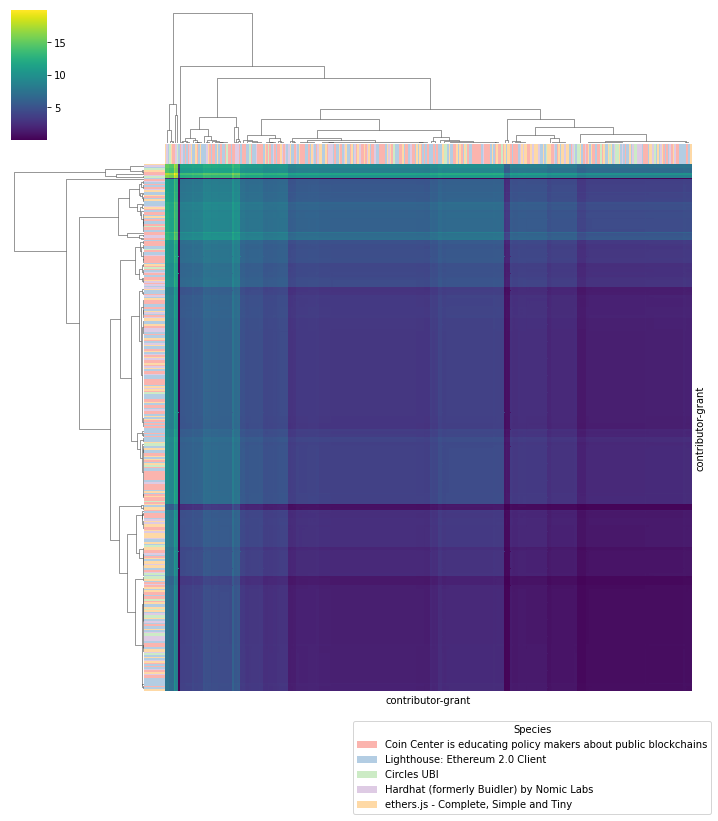

In [7]:
# Filter out the top 5 grants with most contributions
top_grants = contributions_totals.groupby('grant').sum().sort_values('amount').tail(5)
x = contributions_totals.loc[(slice(None), top_grants.index), :]

# Get the outer product on the contributions totals vector
# Thanks @cs95
# https://stackoverflow.com/questions/47912611/compute-matrix-of-outer-operations-on-pandas-series
y = np.array(x.amount.tolist())
outer_df = pd.DataFrame(np.outer(y, y.T), index=x.index, columns=x.index)
outer_df = np.log(outer_df + 1)

# Plot a clustermap
grants_index = outer_df.index.get_level_values(1)
rgb_values = sns.color_palette("Pastel1", len(grants_index.unique()))
lut = dict(zip(grants_index.unique(), rgb_values))
row_colors = grants_index.map(lut)

sns.clustermap(outer_df,
               cmap='viridis',
               row_colors=row_colors,
               col_colors=row_colors,
               xticklabels=False,
               yticklabels=False)

handles = [Patch(facecolor=lut[name]) for name in lut]
plt.legend(handles, lut, title='Species',
           bbox_to_anchor=(1, 0), bbox_transform=plt.gcf().transFigure)
plt.show()

#### Cluster map for the aggregated grants

/Users/marc/conda/lib/python3.8/site-packages/pandas/core/generic.py:3887: PerformanceWarning:

dropping on a non-lexsorted multi-index without a level parameter may impact performance.



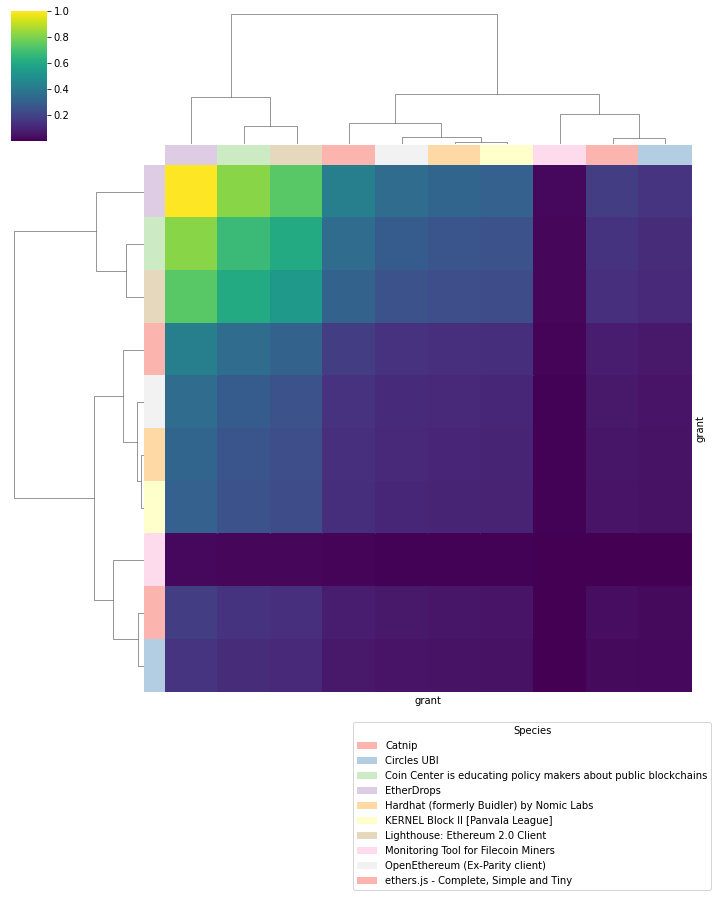

In [8]:
# Filter out the top 10 grants with most contributions
top_grants = contributions_totals.groupby('grant').sum().sort_values('amount').tail(10)
x = contributions_totals.loc[(slice(None), top_grants.index), :]

# Get the outer product on the contributions totals vector
# Thanks @cs95 - https://stackoverflow.com/questions/47912611/compute-matrix-of-outer-operations-on-pandas-series
y = np.array(x.amount.tolist())
outer_df = np.log(pd.DataFrame(np.outer(y, y.T), index=x.index, columns=x.index) + 1)

outer_df = (outer_df.reset_index()
                    .groupby('grant')
                    .sum()
                    .T
                    .groupby('grant')
                    .sum()
                    .pipe(lambda df: df / df.max().max())
           )

# Plot a clustermap
grants_index = outer_df.index
rgb_values = sns.color_palette("Pastel1", len(grants_index.unique()))
lut = dict(zip(grants_index.unique(), rgb_values))
row_colors = grants_index.map(lut)

g = sns.clustermap(outer_df,
                   cmap='viridis',
                   row_colors=row_colors,
                   col_colors=row_colors,
                   xticklabels=False,
                   yticklabels=False)
                   
plt.setp(g.ax_heatmap.get_xticklabels(), rotation=45) # For x axis

handles = [Patch(facecolor=lut[name]) for name in lut]
plt.legend(handles, lut, title='Species',
           bbox_to_anchor=(1, 0), bbox_transform=plt.gcf().transFigure)
plt.show()


### Gitcoin Communities


#### Growth of detected communities over time

In [9]:
def total_amount(G: nx.Graph,
                 node: str) -> float:
    """
    Get the total amount in USDT of contribution
    for a given node (grant or contributor)
    """
    # Get all the graph edges associated with the node
    node_edges = G.edges([node])
    
    # Sum all amounts contained in the edges that contains the node
    total_amount = sum(G.edges[edge]['amount']
                       for edge
                       in node_edges)
    
    # Return it
    return total_amount

def amount_to_degree_ratio(G: nx.Graph,
                 node: str) -> float:
    """
    Get the ration amount/degree 
    for a given node (grant or contributor)
    """
    # Get all the graph edges associated with the node
    node_edges = G.edges([node])
    
    # Sum all amounts contained in the edges that contains the node
    total_amount = sum(G.edges[edge]['amount']
                       for edge
                       in node_edges)
    
    # Return it
    return total_amount/G.degree[node]



In [10]:
def contributions_to_graph(contrib_row: list) -> nx.Graph:
    """
    Convert a contributions row from the cadCAD results DataFrame
    into a NetworkX graph.
    """
    # Make sure that we have data
    if len(contrib_row) > 0:
        
        # Load data
        c_df = pd.DataFrame(contrib_row)
        
        # Parse the contributions into a NetworkX graph
        G = nx.from_pandas_edgelist(c_df,
                                    source='contributor',
                                    target='grant',
                                    edge_attr=True)
        
        # Get unique grants and contributors
        unique_grants = c_df.grant.unique()
        unique_contributors = c_df.contributor.unique()
        
        # Associate the 'type' and 'total_amount' attributes for grants and contributors
        grant_node_type = {el: {'type': 'grant',
                                'total_amount': total_amount(G, el)} 
                           for el in unique_grants}
        contrib_node_type = {el: {'type': 'contributor',
                                  'total_amount': total_amount(G, el)} 
                             for el in unique_contributors}
        node_type = {**grant_node_type, **contrib_node_type}    
        
        nx.set_node_attributes(G, node_type)
        
        # Return the graph
        return G
    else:
        return None

# Generate a time series of NetworkX graphs
graphs = result.contributions.map(contributions_to_graph)

In [11]:
def contributions_to_graph2(contrib_row: list) -> nx.Graph:
    """
    Convert a contributions row from the cadCAD results DataFrame
    into a NetworkX graph.
    """
    # Make sure that we have data
    if len(contrib_row) > 0:
        
        # Load data
        c_df = pd.DataFrame(contrib_row)
        # print(c_df)
        
        # Parse the contributions into a NetworkX graph
        G = nx.from_pandas_edgelist(c_df,
                                    source='contributor',
                                    target='grant',
                                    edge_attr=True)
        
        # Get unique grants and contributors
        unique_grants = c_df.grant.unique()
        unique_contributors = c_df.contributor.unique()
        
        # Associate the 'type' and 'total_amount' attributes for grants and contributors
        grant_node_type = {el: {'type': 'grant',
                                'ratio': amount_to_degree_ratio(G, el),
                                 'total_amount': total_amount(G, el),
                                'degree': G.degree[el]} 
                           for el in unique_grants}
        contrib_node_type = {el: {'type': 'contributor',
                                  'ratio': amount_to_degree_ratio(G, el),
                                   'total_amount': total_amount(G, el),
                                  'degree': G.degree[el]} 
                             for el in unique_contributors}
        node_type = {**grant_node_type, **contrib_node_type}    
        
        nx.set_node_attributes(G, node_type)
        
        # Return the graph
        return G
    else:
        return None

In [12]:
(list(result.contributions))[2]

[{'time_sequence': 0,
  'contributor': 'a0b99288e1',
  'grant': 'Coin Center is educating policy makers about public blockchains',
  'amount': 95.0,
  'flag': 0},
 {'time_sequence': 1,
  'contributor': '55d1f7cbf0',
  'grant': 'Bankless',
  'amount': 39.89999999999999,
  'flag': 0}]

In [13]:
graphs2 = []
for c in result.contributions:
    graphs2.append(contributions_to_graph2(c))



In [14]:
# Function for counting the total detected communities in a graph
community_count = lambda x: len(community.greedy_modularity_communities(x))

# Count it for all graphs that we have
output = {}
for i, G in enumerate(tqdm(graphs2[1:1000])):
    output[i + 1] = community_count(G) 

100%|██████████| 999/999 [01:03<00:00, 15.75it/s]


In [15]:
# Visualize the time series of the community count

# Parse and clean the output from the last cell
s = pd.Series(output)
s.name = 'community_count'
s.index.name = 'event_sequence'

# Visualize it
fig_df = s.reset_index()
px.line(fig_df,
        x='event_sequence',
        y='community_count')

#### Fluid Communities

##### Preparation

In [130]:
list(graphs2[5].nodes().data())

[('a0b99288e1',
  {'type': 'contributor', 'ratio': 95.0, 'total_amount': 95.0, 'degree': 1}),
 ('Coin Center is educating policy makers about public blockchains',
  {'type': 'grant',
   'ratio': 67.44999999999999,
   'total_amount': 134.89999999999998,
   'degree': 2}),
 ('55d1f7cbf0',
  {'type': 'contributor',
   'ratio': 39.89999999999999,
   'total_amount': 159.59999999999997,
   'degree': 4}),
 ('Bankless',
  {'type': 'grant',
   'ratio': 39.89999999999999,
   'total_amount': 39.89999999999999,
   'degree': 1}),
 ('The Defiant',
  {'type': 'grant',
   'ratio': 39.89999999999999,
   'total_amount': 39.89999999999999,
   'degree': 1}),
 ('The Daily Gwei by Anthony Sassano (sassal0x)',
  {'type': 'grant',
   'ratio': 39.89999999999999,
   'total_amount': 39.89999999999999,
   'degree': 1})]

In [175]:
import random
import math

In [176]:
number_of_colors = 20
unique_grants = df.grant.unique()
unique_contributors = df.contributor.unique()
color = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             for i in range(number_of_colors)]
grants_2_color = {}
contributiors_2_color = {}
for grant in unique_grants:
    grants_2_color[grant] = color[random.randint(0, 19)]
for contributor in unique_contributors:
    contributiors_2_color[contributor] = color[random.randint(0, 19)]
    


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
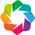

In [177]:
import holoviews as hv
import holoviews.plotting.mpl
from holoviews import opts, dim
hv.extension("bokeh")
defaults = dict(width=800, height=800)
hv.opts.defaults(
    opts.EdgePaths(**defaults), opts.Graph(**defaults), opts.Nodes(**defaults))

In [221]:
def make_points(G: nx.graph, t: str):
    ps = []
    nodes = list(G.nodes().data())
    for node in nodes:
        if t == node[1]['type']:
            ps.append([ node[1]['degree'], node[1]['ratio'], grants_2_color[node[0]], node[1]['total_amount']*0.005 ])
    popts = opts.Points(color='z', size=dim('size'))

    points = hv.Points(ps, vdims=['z', 'size'])
    points.opts(popts)  
    return points


In [222]:

def hvplot_points_sequence(Gs: list, range1=1000, step=20):
    # TODO add test
    hmap = hv.HoloMap({i:make_points(graphs2[i], 'grant') for i in range(1,range1, step)})
    return hmap

hmap = hvplot_points_sequence(graphs2, 6000, 100)

In [223]:
hmap

:HoloMap   [Default]
   :Points   [x,y]   (z,size)

In [52]:
def hvplot_graph(G: nx.Graph):
    # TODO add test
    colors = hv.Cycle('Category10').values

    graph = hv.Graph.from_networkx(G, nx.layout.spring_layout, k=0.7)
    # print(graph)
    # labels = hv.Labels(graph.nodes, ['x', 'y'], 'amount')
    
    graph.opts(cmap=colors, node_color='index', edge_line_width=hv.dim('amount')*0.01, node_size=10, height=800, width=800, tools=['hover', 'box_select'], edge_hover_line_color='red', edge_color_index='amount', node_hover_fill_color='red')
    # graph.opts(
    # opts.Graph(node_color='type', edge_color='Weight', cmap='Set1',
    #            edge_cmap='viridis', edge_line_width=hv.dim('Weight')*10))

    # return (graph * labels.opts(text_font_size='8pt', text_color='white', bgcolor='gray'))
    return graph

def hvplot_graph_sequence(df: pd.DataFrame, step=20):
    # TODO add test
    hmap = hv.HoloMap({i:hvplot_graph(df.iloc[i]['network']) for i in range(0,len(df),step)})
    return hmap

def hvplot_graph2_sequence(Gs: list, range1=1000, step=1):
    # TODO add test
    hmap = hv.HoloMap({i:hvplot_graph(Gs[i]) for i in range(1,range1, step)})
    return hmap

In [53]:
hvplot_graph(graphs2[6000])

:Graph   [start,end]   (amount,flag,time_sequence)

In [30]:
sorted(graphs2[2].nodes.data(), key=lambda node: node[1]['ratio'])

[('55d1f7cbf0',
  {'type': 'contributor',
   'ratio': 39.89999999999999,
   'total_amount': 39.89999999999999,
   'degree': 1}),
 ('Bankless',
  {'type': 'grant',
   'ratio': 39.89999999999999,
   'total_amount': 39.89999999999999,
   'degree': 1}),
 ('a0b99288e1',
  {'type': 'contributor', 'ratio': 95.0, 'total_amount': 95.0, 'degree': 1}),
 ('Coin Center is educating policy makers about public blockchains',
  {'type': 'grant', 'ratio': 95.0, 'total_amount': 95.0, 'degree': 1})]

In [41]:
hmap = hvplot_graph2_sequence(graphs2, 100, 5)
hmap

:HoloMap   [Default]
   :Graph   [start,end]   (amount,flag,time_sequence)

In [48]:
dmap = hv.DynamicMap(lambda x: hvplot_graph(graphs2[x]), kdims=["step"])
dmap.redim.range(step=(1,5))

:DynamicMap   [step]
   :Graph   [start,end]   (amount,flag,time_sequence)

In [34]:
panel.Pane(hmap).show()

Launching server at http://localhost:57024


In [24]:
# Get the last graph
G = contributions_to_graph(result.iloc[-1].contributions)

# Set the sizes and colors
for node, data in G.nodes(data=True):
    data['group'] = data['type']
    data['size'] = np.sqrt(data['total_amount'])

# Print the content of the cadCAD node
G.nodes['cadCAD: Computer Aided Design for Complex Systems']

{'type': 'grant',
 'total_amount': 80.63361904193067,
 'group': 'grant',
 'size': 8.979622433149997}

In [25]:
# Get the largest connected component, this is need for the fluid communities algorithm
giant_component = sorted(nx.connected_components(G), key=len, reverse=True)
G0 = G.subgraph(giant_component[0])

# Get a list of list of nodes.
communities = list(community.asyn_fluidc(G0, 5, seed=SEED))

##### Graph visualization, colored by community

In [26]:
# Thanks!
# https://stackoverflow.com/questions/26139423/plot-different-color-for-different-categorical-levels-using-matplotlib
# https://stackoverflow.com/questions/3380726/converting-a-rgb-color-tuple-to-a-six-digit-code-in-python

# Map categorical colors. Optional
from colormap import rgb2hex
N = len(communities)
color_labels = range(N)
rgb_values = sns.color_palette("Set2", N)
color_map = dict(zip(color_labels, rgb_values))
color_map = {key: rgb2hex(*[int(255 * i) for i in tup])
             for (key, tup) in color_map.items()}

# Associate colors with the node community
attr_map = {}
for i, comm in enumerate(communities):
    community_map = {node: {'group': color_map[i]}
                     for node in comm}
    attr_map = {**attr_map, **community_map}
nx.set_node_attributes(G, attr_map)

# Plot it
nw.visualize(G, config=NETWORK_VIZ_CONFIG)

(None, None)

##### Graph visualization, colored by type

In [18]:
# Thanks!
# https://stackoverflow.com/questions/26139423/plot-different-color-for-different-categorical-levels-using-matplotlib
# https://stackoverflow.com/questions/3380726/converting-a-rgb-color-tuple-to-a-six-digit-code-in-python

# Map categorical colors. Optional
N = 2
color_labels = range(N)
rgb_values = sns.color_palette("Set2", N)
color_map = dict(zip(color_labels, rgb_values))
color_map = {key: rgb2hex(*[int(255 * i) for i in tup])
             for (key, tup) in color_map.items()}

# Associate colors with the node type
node_attr = {}
for i, typ in enumerate(['grant', 'contributor']):
    type_attr = {node: {'group': color_map[i]}
                 for (node, d) in G.nodes(data=True)
                 if d['type'] == typ}
    node_attr = {**node_attr, **type_attr}
nx.set_node_attributes(G, node_attr)

# Plot it
nw.visualize(G, config=NETWORK_VIZ_CONFIG)

(None, None)

##### Prepare community subgraph visualizations

In [8]:
def plot_community(G0: nx.Graph,
                   communities: list,
                   community_label: str):
    """
    Visualize a community subgraph.
    """
    # Get a generator for finding the community
    # on which the `community_label` is located.
    # Returns `None` if not found.
    generator = (g
                 for g in communities
                 if community_label in g)

    # Find the first instance where the conditions is valid
    community_nodes = next(generator, None)

    if community_nodes is None:
        print(f"Community f{community_label} was not detected in the giant component")
        return None
    else:
        subgraph = G0.subgraph(community_nodes)
        
        # Number of grants on the subgraph
        N_grants = sum(1 
                       for label, node 
                       in subgraph.nodes(data=True) 
                       if node['type'] == 'grant')
        
        # Number of contributors on the subgraph
        N_contributors = sum(1 
                             for label, node 
                             in subgraph.nodes(data=True) 
                             if node['type'] == 'contributor')
        
        # Total amount in USDT on the subgraph
        subgraph_amount = sum(subgraph.edges[edge]['amount'] 
                              for edge 
                              in subgraph.edges())
        
        # Total amount per grant on the subgraph
        grant_amounts = {label: node['total_amount']
                         for (label, node) in subgraph.nodes(data=True)
                         if node['type'] == 'grant'}
        
        # Top 5 grants on the subgraph
        top_5_grants = sorted(grant_amounts.items(),
                              key=lambda it: it[1])[-5:]
        
        # Print everything
        print(f"Total grants: {N_grants}")
        print(f"Total collaborators: {N_contributors}")
        print(f"Total USD value inside the subgraph: {subgraph_amount:,.2f} USD")
        print("Top 5 grants")
        print("---")
        for (grant, amount) in top_5_grants[::-1]:
            print(f"{grant}: {amount:,.2f} USD")
        
        # Visualize the subgraph
        return nw.visualize(subgraph, config=NETWORK_VIZ_CONFIG)

##### cadCAD: Computer Aided Design for Complex System

In [21]:
plot_community(G0, 
               communities, 
               'cadCAD: Computer Aided Design for Complex Systems')

Total grants: 136
Total collaborators: 246
Total USD value inside the subgraph: 36,767.52 USD
Top 5 grants
---
Hardhat (formerly Buidler) by Nomic Labs: 8,410.78 USD
Circles UBI: 6,762.94 USD
ethers.js - Complete, Simple and Tiny: 3,445.22 USD
Catnip: 3,035.16 USD
OpenEthereum (Ex-Parity client): 2,493.97 USD


(None, None)

##### MetaGame

In [22]:
plot_community(G0, 
               communities, 
               'MetaGame')

Total grants: 98
Total collaborators: 202
Total USD value inside the subgraph: 6,357.00 USD
Top 5 grants
---
Grassroots Economics CIC Support - Kenya & Beyond: 1,187.72 USD
The Commons Stack: Iteration 0: 1,140.19 USD
Integrate Flexa Spend SDK in Nighthawk Wallet: 1,042.37 USD
APY.Vision: 855.21 USD
web3swift - Elegant Web3 functionality in Swift: 722.28 USD


(None, None)

##### DAppChaser

In [23]:
plot_community(G0, 
               communities, 
               'DAppChaser')

Total grants: 40
Total collaborators: 232
Total USD value inside the subgraph: 8,622.14 USD
Top 5 grants
---
EtherDrops: 3,361.53 USD
KERNEL Block II [Panvala League]: 2,873.05 USD
Zcash Serverless Store (Unofficial): 1,000.00 USD
DAppChaser: 877.84 USD
Solexplorer - Gitcoin Community Manager: 580.00 USD


(None, None)